# kaggle-final-notebook

https://www.kaggle.com/competitions/playground-series-s3e1/, Rybczyński Jędrzej 29.01.2023


In [9]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import json

# import geopandas as gpd
# import geoplot as gplt
# import geoplot.crs as gcrs
# import mapclassify as mc

from pandas_profiling import ProfileReport

import warnings
warnings.filterwarnings('ignore')

## EDA

### General

In [10]:
df = pd.read_csv('./data/train.csv')
df = df.drop(columns=['id'])

In [11]:
df

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal
0,2.3859,15.0,3.827160,1.112100,1280.0,2.486989,34.60,-120.12,0.980
1,3.7188,17.0,6.013373,1.054217,1504.0,3.813084,38.69,-121.22,0.946
2,4.7750,27.0,6.535604,1.103175,1061.0,2.464602,34.71,-120.45,1.576
3,2.4138,16.0,3.350203,0.965432,1255.0,2.089286,32.66,-117.09,1.336
4,3.7500,52.0,4.284404,1.069246,1793.0,1.604790,37.80,-122.41,4.500
...,...,...,...,...,...,...,...,...,...
37132,3.3438,50.0,4.936508,1.079365,1775.0,3.022222,34.19,-118.36,1.856
37133,3.7308,26.0,5.087533,0.966019,1006.0,4.316901,37.32,-121.86,1.588
37134,4.1716,52.0,4.678862,1.101485,1156.0,1.431734,37.75,-122.44,3.387
37135,2.7143,16.0,5.710074,1.068376,584.0,2.803659,38.40,-120.98,1.592


In [12]:
df.info() # all numeric features

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37137 entries, 0 to 37136
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   MedInc       37137 non-null  float64
 1   HouseAge     37137 non-null  float64
 2   AveRooms     37137 non-null  float64
 3   AveBedrms    37137 non-null  float64
 4   Population   37137 non-null  float64
 5   AveOccup     37137 non-null  float64
 6   Latitude     37137 non-null  float64
 7   Longitude    37137 non-null  float64
 8   MedHouseVal  37137 non-null  float64
dtypes: float64(9)
memory usage: 2.6 MB


### pandas-profiling

In [13]:
profile = ProfileReport(df, title="Pandas Profiling Report")

In [14]:
profile.to_widgets()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render widgets:   0%|          | 0/1 [00:00<?, ?it/s]

In [15]:
correlations = profile.description_set["correlations"]
print(correlations['auto']['MedHouseVal'].sort_values(ascending=False))

MedHouseVal    1.000000
MedInc         0.697265
AveRooms       0.309516
HouseAge       0.062783
Population    -0.042108
Longitude     -0.113271
AveBedrms     -0.121262
Latitude      -0.132997
AveOccup      -0.224818
Name: MedHouseVal, dtype: float64


### dython

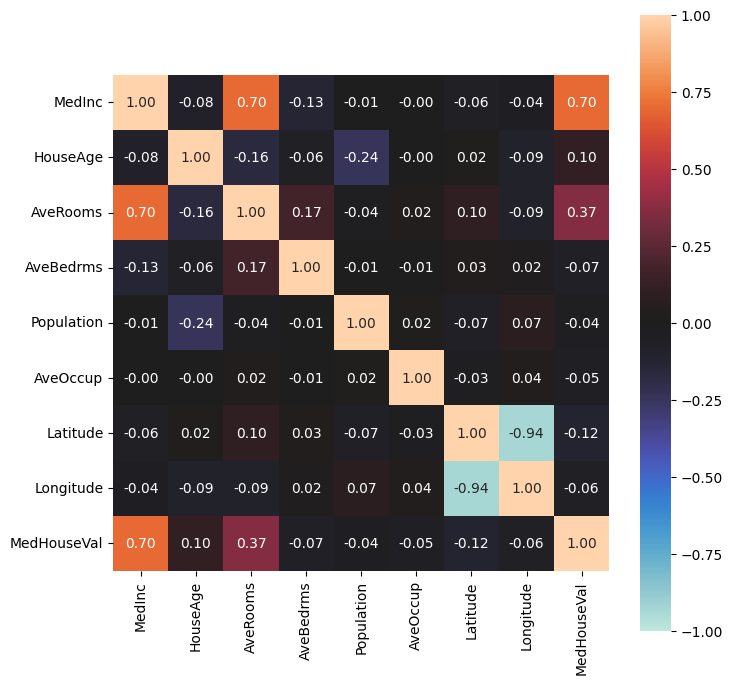

In [16]:
from dython.nominal import associations
%matplotlib inline

associations(df, figsize=(8, 8))['ax'];

#### disclaimer: 
serdecznie polceam powyższą bibliotekę, [dython](http://shakedzy.xyz/dython/) jest o tyle wygodny, że można wyświetlić macierz korelacji, która rozważa wszystkie typy korelacji zmiennych num-num, cat-num, cat-cat. Jako miary korelacji domyślnie wykorzystuje odpowiednio pearson, eta (from ANOVA), cramer-V, ale to też można sobie dostosować.

### California map

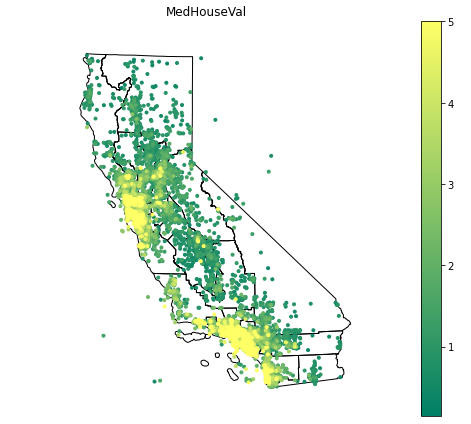

In [17]:
from IPython.display import Image

# mapka .png zapisana z wywołanego kernela na kagglu, dlatego, że z nieznanych mi przyczyn 
# za nic nie mogłem zainstalować jednego z pakietów potrzebnych do jej rysowania na lokalnym notebooku
Image(filename='./data/medhouseval_map.png')

In [18]:
from folium import plugins
from folium.plugins import HeatMap
import folium
import branca

inferno_colors = [
    (0, 0, 4),
    (40, 11, 84),
    (101, 21, 110),
    (159, 42, 99),
    (212, 72, 66),
    (245, 125, 21),
    (250, 193, 39),
    (252, 255, 164)
]

map = folium.Map(df[['Latitude', 'Longitude']].mean(axis=0), zoom_start = 6)
lat = list(df.Latitude)
lon = list(df.Longitude)
populations = list(df.Population)
targets = list(df.MedHouseVal)

cmap = branca.colormap.LinearColormap(
    inferno_colors, vmin=min(targets), vmax=max(targets)
)

for loc, population, target in zip(zip(lat, lon), populations, targets):
    folium.Circle(
        location=loc,
        radius=population,
        fill=True,
            color=cmap(target),
        fill_opacity=0.2,
        weight=0
    ).add_to(map)

map.add_child(cmap)
display(map)

Widać, że najwyższą cenę mają mieszkania zlokalizowane blisko linii brzegowej, na cenę może też mieć wpływ lokalizacja bliżej poszczególnych aglomeracji miejskich. Uwzględnimy te informacje na etapie feature engineeringu.

## Features Engineering

In [19]:
df_fe = df.copy()

### (Long/Lat)itude features engineering

based on: https://bmanikan.medium.com/feature-engineering-all-i-learned-about-geo-spatial-features-649871d16796

In [20]:
df_fe['r'] = np.sqrt(df_fe['Latitude']**2 + df_fe['Longitude']**2)
df_fe['theta'] = np.arctan2(df_fe['Latitude'], df_fe['Longitude'])

In [21]:
df_fe['rot_15_x'] = (np.cos(np.radians(15)) * df_fe['Longitude']) + (np.sin(np.radians(15)) * df_fe['Latitude'])
df_fe['rot_15_y'] = (np.cos(np.radians(15)) * df_fe['Latitude']) - (np.sin(np.radians(15)) * df_fe['Longitude'])

df_fe['rot_30_x'] = (np.cos(np.radians(30)) * df_fe['Longitude']) + (np.sin(np.radians(30)) * df_fe['Latitude'])
df_fe['rot_30_y'] = (np.cos(np.radians(30)) * df_fe['Latitude']) - (np.sin(np.radians(30)) * df_fe['Longitude'])

df_fe['rot_45_x'] = (np.cos(np.radians(45)) * df_fe['Longitude']) + (np.sin(np.radians(45)) * df_fe['Latitude'])
df_fe['rot_45_y'] = (np.cos(np.radians(45)) * df_fe['Latitude']) - (np.sin(np.radians(45)) * df_fe['Longitude'])

In [22]:
from sklearn.decomposition import PCA

def pca(data):
    '''
    input: dataframe containing Latitude(x) and Longitude(y)
    '''
    coordinates = data[['Latitude','Latitude']].values
    pca_obj = PCA().fit(coordinates)
    pca_x = pca_obj.transform(data[['Latitude', 'Longitude']].values)[:,0]
    pca_y = pca_obj.transform(data[['Latitude', 'Longitude']].values)[:,1]
    return pca_x, pca_y

df_fe['pca_x'], df_fe['pca_y'] = pca(df_fe)

In [23]:
import reverse_geocoder as rg

def geocoder(data):
    '''
    input: dataframe containing Latitude(x) and Longitude(y) coordinates
    output: JSON data containing info on available building or street names.
    '''
    coordinates = list(zip(data['Latitude'].values, data['Longitude'].values))
    results = rg.search(coordinates) # default mode = 2
    return results

def get_values(df, column):
    return df[column].value_counts(normalize=True)[df[column].value_counts(normalize=True) < 0.005].index.tolist()

geocoder_data = geocoder(df_fe)

df_fe['admin2'] = [val['admin2'] for val in geocoder_data]
df_fe['admin2'][df_fe['admin2'].isin(get_values(df_fe, 'admin2'))] = 'Other'
df_fe['admin2'].value_counts()

Loading formatted geocoded file...


Los Angeles County       11404
Orange County             3017
San Diego County          2817
Santa Clara County        2282
Alameda County            1855
Other                     1835
Sacramento County         1832
San Bernardino County     1498
Contra Costa County       1274
San Mateo County          1196
Riverside County          1126
San Joaquin County         846
San Francisco County       830
Fresno County              807
Ventura County             604
Kern County                505
Stanislaus County          475
Sonoma County              367
Santa Barbara County       354
Solano County              319
Marin County               313
Tulare County              299
Santa Cruz County          237
Yolo County                227
Butte County               221
Monterey County            218
Shasta County              192
Merced County              187
Name: admin2, dtype: int64

### Distance to larger cities

In [24]:
import geopy.distance

sacramento = (38.576931, -121.494949)
san_francisco = (37.780080, -122.420160)
san_jose = (37.334789, -121.888138)
los_angeles = (34.052235, -118.243683)
san_diego = (32.715759, -117.163818)

df_fe['sacramento_distance'] = [geopy.distance.geodesic(sacramento, row).km for row in (list(zip(df_fe['Latitude'].values, df_fe['Longitude'].values)))]
df_fe['san_francisco_distance'] = [geopy.distance.geodesic(san_francisco, row).km for row in (list(zip(df_fe['Latitude'].values, df_fe['Longitude'].values)))]
df_fe['san_jose_distance'] = [geopy.distance.geodesic(san_jose, row).km for row in (list(zip(df_fe['Latitude'].values, df_fe['Longitude'].values)))]
df_fe['los_angeles_distance'] = [geopy.distance.geodesic(los_angeles, row).km for row in (list(zip(df_fe['Latitude'].values, df_fe['Longitude'].values)))]
df_fe['san_diego_distance'] = [geopy.distance.geodesic(san_diego, row).km for row in (list(zip(df_fe['Latitude'].values, df_fe['Longitude'].values)))]

### Distance to coastline

In [25]:
from tqdm.auto import tqdm
tqdm.pandas()

with open('./data/stanford-vx275xn8886-geojson.json', 'r') as f:
    coastline = json.load(f)
    features = coastline['features']

# Unpacks California coastline coordinates and builds a dataframe. shape=(25693, 2) 
cstl_coords = [features[i]['geometry']['coordinates'] for i in range(len(features))]
cstl_coords = np.hstack(cstl_coords).reshape((-1, 2))
cstl_df = pd.DataFrame(cstl_coords, columns=['Longitude', 'Latitude'])

# Finds the shortest distance to the coastline (Euclidian Distance).
def f(lat, lon, df):
    return (((df.Latitude - lat)**2 + (df.Longitude - lon)**2)**.5).min()

df_fe['dist_to_cstl'] = df_fe.progress_apply(lambda x: f(x.Latitude, x.Longitude, cstl_df), axis=1)

  0%|          | 0/37137 [00:00<?, ?it/s]

### Additional features from existing ones

In [26]:
# df_fe['size_of_block'] = df_fe['Population'] / df_fe['AveOccup']

# df_fe['income_of_block'] = df_fe['MedInc'] * df_fe['Population']

df_fe['occupants/bedrooms'] = df_fe['AveOccup'] / df_fe['AveBedrms']

df_fe['unused_bedrooms'] = df_fe['AveBedrms'] - df_fe['AveOccup']

# df_fe['total_rooms'] = df_fe['AveBedrms'] + df_fe['AveRooms']

# df_fe['non_bedrooms'] = df_fe['AveRooms'] - df_fe['AveBedrms']

# df_fe['bedrooms/rooms'] = df_fe['AveBedrms'] / df_fe['AveRooms']

df_fe['occupants/rooms'] = df['AveOccup'] / df_fe['AveRooms']

In [27]:
df_fe.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal,r,...,admin2,sacramento_distance,san_francisco_distance,san_jose_distance,los_angeles_distance,san_diego_distance,dist_to_cstl,occupants/bedrooms,unused_bedrooms,occupants/rooms
0,2.3859,15.0,3.827160,1.112100,1280.0,2.486989,34.60,-120.12,0.980,125.003898,...,Santa Barbara County,458.134044,409.012151,342.788208,183.052903,344.732819,0.127840,2.236300,-1.374889,0.649826
1,3.7188,17.0,6.013373,1.054217,1504.0,3.813084,38.69,-121.22,0.946,127.244664,...,Sacramento County,27.031041,145.744557,161.460772,579.723377,757.503828,1.572543,3.616983,-2.758867,0.634101
2,4.7750,27.0,6.535604,1.103175,1061.0,2.464602,34.71,-120.45,1.576,125.351452,...,Santa Barbara County,439.163949,383.917714,318.779074,215.628996,376.411459,0.150547,2.234099,-1.361427,0.377104
3,2.4138,16.0,3.350203,0.965432,1255.0,2.089286,32.66,-117.09,1.336,121.559630,...,San Diego County,768.022771,746.806583,678.630234,188.076433,9.282298,0.059203,2.164094,-1.123854,0.623630
4,3.7500,52.0,4.284404,1.069246,1793.0,1.604790,37.80,-122.41,4.500,128.113419,...,San Francisco County,117.742658,2.385218,69.220951,560.491683,738.694414,0.105530,1.500861,-0.535544,0.374566


## Modeling 

In [171]:
from sklearn.model_selection import train_test_split

y = df['MedHouseVal']
X = df.drop(columns=['MedHouseVal'])

y_fe = df_fe['MedHouseVal']
X_fe = df_fe.drop(columns=['MedHouseVal'])

y_fe = df_fe['MedHouseVal']
X_fe_oh = pd.get_dummies(df_fe.drop(columns=['MedHouseVal']))

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)
X_train_fe, X_test_fe, y_train_fe, y_test_fe = train_test_split(X_fe, y_fe, test_size=0.1, random_state=42)
X_train_fe_oh, X_test_fe_oh, y_train_fe, y_test_fe = train_test_split(X_fe_oh, y_fe, test_size=0.1, random_state=42)

In [91]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

def evaluate_model(pred: np.array, y_test: pd.Series, model_name: str):
    """
    Util function for evaluating model.
    
    Args:
        pred: predictions np.array
        y_test: actual values pd.Series
        model_name: str for labeling results dataframe

    Returns:
        Results pd.DataFrame.
    """
    
    rmse = mean_squared_error(y_test, pred, squared=False)
    mae = mean_absolute_error(y_test, pred)
    r2 = r2_score(y_test, pred)
    
    results = pd.DataFrame({'RMSE': [rmse],
                            'MAE': [mae],
                            'R2': [r2]}, 
                           index=[model_name])
    
    return results.T

### 0) PyCaret skim through

In [55]:
from pycaret.regression import *

X_train_pycaret = X_train.copy()
X_train_pycaret['MedHouseVal'] = y_train
X_test_pycaret = X_test.copy()
X_test_pycaret['MedHouseVal'] = y_test

s = setup(data=X_train_pycaret, test_data=X_test_pycaret, target='MedHouseVal')

,Description,Value
0,Session id,8447
1,Target,MedHouseVal
2,Target type,Regression
3,Original data shape,"(37137, 9)"
4,Transformed data shape,"(37137, 9)"
5,Transformed train set shape,"(33423, 9)"
6,Transformed test set shape,"(3714, 9)"
7,Numeric features,8
8,Preprocess,True
9,Imputation type,simple


In [31]:
best = compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
catboost,CatBoost Regressor,0.3981,0.3143,0.5604,0.7649,0.1685,0.2225,1.9240
lightgbm,Light Gradient Boosting Machine,0.4022,0.3209,0.5663,0.7599,0.1700,0.2250,0.1790
xgboost,Extreme Gradient Boosting,0.4110,0.3349,0.5785,0.7495,0.1747,0.2301,0.4700
rf,Random Forest Regressor,0.4184,0.3501,0.5915,0.7381,0.1773,0.2354,1.7730
gbr,Gradient Boosting Regressor,0.4266,0.3525,0.5936,0.7363,0.1791,0.2418,0.6570
et,Extra Trees Regressor,0.4255,0.3605,0.6002,0.7304,0.1785,0.2377,0.9750
omp,Orthogonal Matching Pursuit,0.6149,0.6735,0.8206,0.4961,0.2532,0.3725,0.0230
dt,Decision Tree Regressor,0.5771,0.6940,0.8329,0.4809,0.2475,0.3184,0.0500
ada,AdaBoost Regressor,0.7091,0.7037,0.8383,0.4734,0.2831,0.5180,0.2190
en,Elastic Net,0.6806,0.7683,0.8765,0.4253,0.2773,0.4530,0.0210


Processing:   0%|          | 0/85 [00:00<?, ?it/s]

In [54]:
e(best)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

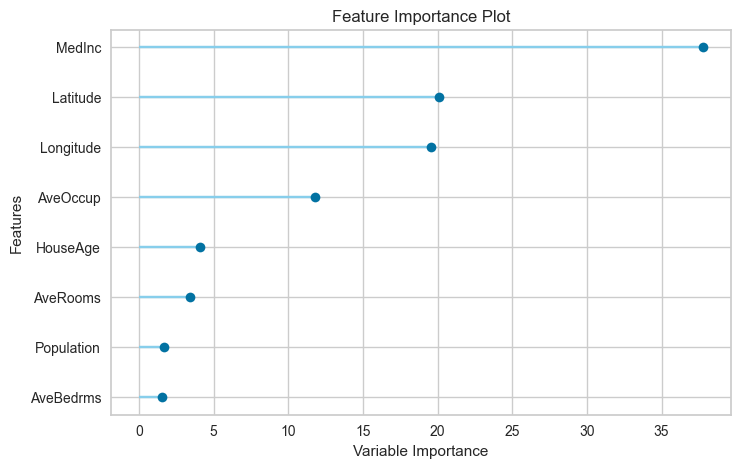

In [35]:
plot_model(best, plot = 'feature')

In [47]:
predict_model(best)

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,CatBoost Regressor,0.4112,0.3483,0.5902,0.7491,0.1742,0.2218


,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal,prediction_label
33423,5.0855,17.0,6.190804,1.105747,1538.0,3.373563,38.020000,-121.360001,1.03500,1.705105
33424,3.3636,5.0,4.239899,1.020202,3278.0,2.066007,33.680000,-117.529999,1.96900,1.650698
33425,5.0417,29.0,6.602316,1.023529,1119.0,2.705479,33.840000,-117.949997,2.63800,2.555404
33426,4.1364,22.0,5.448584,0.986717,1750.0,3.020478,38.470001,-121.769997,1.18800,1.470864
33427,1.6031,39.0,4.742204,1.075092,1168.0,3.250000,36.750000,-119.800003,0.66900,0.485405
...,...,...,...,...,...,...,...,...,...,...
37132,5.4607,21.0,6.093458,1.001565,1660.0,3.266169,38.709999,-121.260002,3.27200,1.916347
37133,6.4913,36.0,6.289474,0.984211,549.0,2.842105,34.200001,-118.209999,5.00001,3.718969
37134,1.9872,39.0,4.956522,1.060134,993.0,2.567194,37.270000,-121.000000,0.87500,0.856259
37135,1.5143,11.0,3.832265,1.087786,2950.0,1.515510,38.900002,-121.290001,0.50800,0.735298


### 1) Linear Regression (baseline model)

#### 1.1) Without feature engineering

In [104]:
from sklearn.linear_model import LinearRegression

lr = LinearRegression()

lr.fit(X_train, y_train)
pred = lr.predict(X_test)

In [105]:
evaluate_model(pred, y_test, 'LR baseline w/o FE')

,LR baseline w/o FE
RMSE,0.766195
MAE,0.557903
R2,0.577152


#### 1.2) With feature engineering

In [58]:
from sklearn.linear_model import LinearRegression

lr = LinearRegression()
lr.fit(X_train_fe_oh, y_train_fe)
pred = lr.predict(X_test_fe_oh)

In [59]:
evaluate_model(pred, y_test_fe, 'LR baseline with FE')

,LR baseline with FE
RMSE,0.721288
MAE,0.511777
R2,0.625266


### 2) Random Forest

#### 2.1) Without feature engineering

In [60]:
from sklearn.ensemble import RandomForestRegressor

rf = RandomForestRegressor()
rf.fit(X_train, y_train)
pred = rf.predict(X_test)

In [61]:
evaluate_model(pred, y_test, 'RF w/o FE')

,RF w/o FE
RMSE,0.617813
MAE,0.431867
R2,0.725071


In [62]:
feat_importances = pd.Series(rf.feature_importances_, index=X_test.columns)
feat_importances.nlargest(15)

MedInc        0.550937
AveOccup      0.106568
Longitude     0.097025
Latitude      0.084153
AveRooms      0.053442
HouseAge      0.039593
Population    0.034492
AveBedrms     0.033790
dtype: float64

#### 2.2) With feature engineering

In [63]:
from sklearn.ensemble import RandomForestRegressor

rf = RandomForestRegressor()
rf.fit(X_train_fe_oh, y_train_fe)
pred = rf.predict(X_test_fe_oh)

In [64]:
evaluate_model(pred, y_test_fe, 'RF with FE')

,RF with FE
RMSE,0.603625
MAE,0.420004
R2,0.737554


In [65]:
feat_importances = pd.Series(rf.feature_importances_, index=X_test_fe_oh.columns)
feat_importances.nlargest(15)

MedInc                  0.490129
pca_x                   0.094707
rot_45_x                0.056206
unused_bedrooms         0.041011
AveOccup                0.035613
dist_to_cstl            0.028868
HouseAge                0.023066
Population              0.020255
occupants/rooms         0.020187
AveRooms                0.019906
AveBedrms               0.017107
occupants/bedrooms      0.016731
los_angeles_distance    0.016627
theta                   0.012923
rot_15_x                0.012319
dtype: float64

### 3) CatBoost

#### 3.1) Without feature engineering

In [68]:
from catboost import CatBoostRegressor

X_train_, X_val, y_train_, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42)

model = CatBoostRegressor(iterations=15_000, loss_function='RMSE')
model.fit(X_train_, y_train_, eval_set=(X_val, y_val), early_stopping_rounds=1500, use_best_model=True, verbose=3000);

Learning rate set to 0.016656
0:	learn: 1.1428180	test: 1.1699394	best: 1.1699394 (0)	total: 4.28ms	remaining: 1m 4s
3000:	learn: 0.5053866	test: 0.5609844	best: 0.5609844 (3000)	total: 10s	remaining: 40s
6000:	learn: 0.4639141	test: 0.5597513	best: 0.5595520 (5790)	total: 20s	remaining: 30s
Stopped by overfitting detector  (1500 iterations wait)

bestTest = 0.5593039346
bestIteration = 7263

Shrink model to first 7264 iterations.


In [69]:
pred = model.predict(X_test)
evaluate_model(pred, y_test_fe, 'CatBoost w/o FE')

,CatBoost w/o FE
RMSE,0.589392
MAE,0.411239
R2,0.749784


#### 3.2) With feature engineering

#### 3.2.1) Hold-out validation set

In [86]:
from catboost import CatBoostRegressor

X_train_, X_val, y_train_, y_val = train_test_split(X_train_fe, y_train_fe, test_size=0.1, random_state=42)

model = CatBoostRegressor(iterations=15_000, loss_function='RMSE')
model.fit(X_train_, y_train_, eval_set=(X_val, y_val), early_stopping_rounds=1500,
          cat_features=['admin2'], use_best_model=True, verbose=3000);

Learning rate set to 0.016656
0:	learn: 1.1421804	test: 1.1697840	best: 1.1697840 (0)	total: 31.1ms	remaining: 7m 47s
3000:	learn: 0.4910352	test: 0.5585743	best: 0.5585743 (3000)	total: 2m 11s	remaining: 8m 44s
6000:	learn: 0.4448518	test: 0.5585160	best: 0.5580549 (5507)	total: 4m 9s	remaining: 6m 14s
Stopped by overfitting detector  (1500 iterations wait)

bestTest = 0.5580549388
bestIteration = 5507

Shrink model to first 5508 iterations.


In [87]:
pred = model.predict(X_test_fe)
evaluate_model(pred, y_test, 'CatBoost FE')

,CatBoost FE
RMSE,0.585610
MAE,0.406627
R2,0.752985


In [88]:
feature_importances = model.get_feature_importance()
feature_names = X_train_fe.columns

for score, name in sorted(zip(feature_importances, feature_names), reverse=True):
    print('{}: {}'.format(name, score))

MedInc: 30.073082767039203
pca_x: 6.809828402939727
dist_to_cstl: 6.602899221426804
rot_45_x: 5.311933444868234
occupants/rooms: 4.813020173627935
admin2: 4.040055790128343
unused_bedrooms: 3.46365301900591
HouseAge: 2.9977857618693675
los_angeles_distance: 2.7898284408920273
AveOccup: 2.6985644967394253
Latitude: 2.3395517952009524
san_francisco_distance: 2.124975108328279
Longitude: 2.097584688316303
rot_30_x: 2.006444564177039
occupants/bedrooms: 1.9691213396671554
Population: 1.9248818075018375
AveRooms: 1.8726378519188955
rot_15_y: 1.8677375335306345
san_jose_distance: 1.7439376606898853
AveBedrms: 1.6995525989565057
rot_15_x: 1.6904357965344454
r: 1.6654944399574472
theta: 1.516890200354566
sacramento_distance: 1.4174551191397333
pca_y: 1.221496459619054
san_diego_distance: 1.164569377921616
rot_45_y: 1.0573425663848086
rot_30_y: 1.0192395732638635


#### 3.2.2) Cross-validation & stacking models

In [72]:
from sklearn.model_selection import KFold

rmses = []
models = []
kf = KFold(n_splits=10, random_state=42, shuffle=True)

for train_index, val_index in tqdm(kf.split(X_train_fe)):
    X_train_, X_val = X_train_fe.iloc[train_index], X_train_fe.iloc[val_index]
    y_train_, y_val = y_train_fe.iloc[train_index], y_train_fe.iloc[val_index]

    model = CatBoostRegressor(iterations=15_000, loss_function='RMSE')
    model.fit(X_train_, y_train_, eval_set=(X_val, y_val), cat_features=['admin2'],
              early_stopping_rounds=1500, use_best_model=True, verbose=5000)
    pred = model.predict(X_val)
    
    models.append(model)
    rmses.append(mean_squared_error(y_val, pred, squared=False))
    
print(f'Total RMSE: {np.mean(rmses)}')

0it [00:00, ?it/s]

Learning rate set to 0.016656
0:	learn: 1.1421804	test: 1.1697840	best: 1.1697840 (0)	total: 34.9ms	remaining: 8m 43s
5000:	learn: 0.4585285	test: 0.5577962	best: 0.5576475 (4059)	total: 2m 49s	remaining: 5m 39s
Stopped by overfitting detector  (1500 iterations wait)

bestTest = 0.5576475228
bestIteration = 4059

Shrink model to first 4060 iterations.
Learning rate set to 0.016656
0:	learn: 1.1479688	test: 1.1168862	best: 1.1168862 (0)	total: 29ms	remaining: 7m 14s
5000:	learn: 0.4592230	test: 0.5510426	best: 0.5510407 (4999)	total: 2m 51s	remaining: 5m 42s
Stopped by overfitting detector  (1500 iterations wait)

bestTest = 0.550240285
bestIteration = 8390

Shrink model to first 8391 iterations.
Learning rate set to 0.016656
0:	learn: 1.1431178	test: 1.1578604	best: 1.1578604 (0)	total: 31.4ms	remaining: 7m 50s
5000:	learn: 0.4590889	test: 0.5606921	best: 0.5606675 (4939)	total: 3m 23s	remaining: 6m 46s
Stopped by overfitting detector  (1500 iterations wait)

bestTest = 0.5604955594
be

In [77]:
pred = np.mean(np.stack([model.predict(X_test_fe) for model in models]), axis=0)
evaluate_model(pred, y_test, 'CatBoost 10-CV stacking FE')

,CatBoost 10-CV stacking FE
RMSE,0.583452
MAE,0.405201
R2,0.754803


### 4) Feedforward NN

In [175]:
from keras.models import Sequential
from keras.layers import Dense, BatchNormalization, Dropout
from keras.callbacks import EarlyStopping
from keras import backend as K


def root_mean_squared_error(y_true, y_pred):
        return K.sqrt(K.mean(K.square(y_pred - y_true))) 
    

def create_nn_model(input_shape: int):    
    model = Sequential()

    model.add(Dense(512, activation='relu', input_shape=(input_shape,)))
    model.add(Dense(512, activation='relu'))
    
    model.add(Dropout(0.1))
    
    model.add(Dense(256, activation='relu'))

    model.add(Dense(1))

    model.compile(optimizer='adam', loss=root_mean_squared_error)
    
    return model

#### 4.1) Without feature engineering

In [172]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

X_train_, X_val, y_train_, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42)

In [176]:
model = create_nn_model(X_train.shape[1])
es = EarlyStopping(monitor='val_loss', patience=20, verbose=1, restore_best_weights=True)
model.fit(X_train_, y_train_, batch_size=32, epochs=100, validation_data=(X_val, y_val), callbacks=es)

Epoch 1/100
940/940 [==============================] - 3s 3ms/step - loss: 0.7375 - val_loss: 0.6664
Epoch 2/100
940/940 [==============================] - 3s 3ms/step - loss: 0.6781 - val_loss: 0.6954
Epoch 3/100
940/940 [==============================] - 2s 3ms/step - loss: 0.6708 - val_loss: 0.6486
Epoch 4/100
940/940 [==============================] - 2s 3ms/step - loss: 0.6549 - val_loss: 0.6287
Epoch 5/100
940/940 [==============================] - 2s 3ms/step - loss: 0.6513 - val_loss: 0.6398
Epoch 6/100
940/940 [==============================] - 2s 3ms/step - loss: 0.6421 - val_loss: 0.6284
Epoch 7/100
940/940 [==============================] - 2s 3ms/step - loss: 0.6372 - val_loss: 0.6148
Epoch 8/100
940/940 [==============================] - 2s 3ms/step - loss: 0.6357 - val_loss: 0.6205
Epoch 9/100
940/940 [==============================] - 2s 3ms/step - loss: 0.6323 - val_loss: 0.6137
Epoch 10/100
940/940 [==============================] - 2s 3ms/step - loss: 0.6320 - val_lo

940/940 [==============================] - 3s 3ms/step - loss: 0.5843 - val_loss: 0.5925
Epoch 82/100
940/940 [==============================] - 3s 3ms/step - loss: 0.5839 - val_loss: 0.5987
Epoch 83/100
940/940 [==============================] - 3s 3ms/step - loss: 0.5831 - val_loss: 0.5850
Epoch 84/100
940/940 [==============================] - 3s 3ms/step - loss: 0.5841 - val_loss: 0.5800
Epoch 85/100
940/940 [==============================] - 3s 3ms/step - loss: 0.5813 - val_loss: 0.5876
Epoch 86/100
940/940 [==============================] - 3s 3ms/step - loss: 0.5830 - val_loss: 0.5919
Epoch 87/100
940/940 [==============================] - 3s 3ms/step - loss: 0.5842 - val_loss: 0.6036
Epoch 88/100
940/940 [==============================] - 3s 3ms/step - loss: 0.5829 - val_loss: 0.5958
Epoch 89/100
940/940 [==============================] - 3s 3ms/step - loss: 0.5817 - val_loss: 0.5823
Epoch 90/100
940/940 [==============================] - 3s 3ms/step - loss: 0.5827 - val_loss: 

In [178]:
pred = model.predict(X_test)
evaluate_model(pred, y_test, 'NN w/o FE')

117/117 [==============================] - 0s 1ms/step


,NN w/o FE
RMSE,0.634294
MAE,0.454227
R2,0.710208


#### 4.2) With feature engineering

In [180]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

scaler = MinMaxScaler()
X_train_fe = scaler.fit_transform(X_train_fe.drop(columns=['admin2']))
X_test_fe = scaler.transform(X_test_fe.drop(columns=['admin2']))

X_train_, X_val, y_train_, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42)

In [181]:
model = create_nn_model(X_train_.shape[1])
es = EarlyStopping(monitor='val_loss', patience=20, verbose=1, restore_best_weights=True)
model.fit(X_train_, y_train_, batch_size=32, epochs=100, validation_data=(X_val, y_val), callbacks=es)

Epoch 1/100
940/940 [==============================] - 3s 3ms/step - loss: 0.7520 - val_loss: 0.6726
Epoch 2/100
940/940 [==============================] - 3s 3ms/step - loss: 0.6876 - val_loss: 0.6897
Epoch 3/100
940/940 [==============================] - 3s 3ms/step - loss: 0.6661 - val_loss: 0.6442
Epoch 4/100
940/940 [==============================] - 3s 3ms/step - loss: 0.6527 - val_loss: 0.6360
Epoch 5/100
940/940 [==============================] - 3s 3ms/step - loss: 0.6502 - val_loss: 0.6201
Epoch 6/100
940/940 [==============================] - 3s 3ms/step - loss: 0.6423 - val_loss: 0.6218
Epoch 7/100
940/940 [==============================] - 3s 4ms/step - loss: 0.6382 - val_loss: 0.6555
Epoch 8/100
940/940 [==============================] - 3s 4ms/step - loss: 0.6353 - val_loss: 0.6188
Epoch 9/100
940/940 [==============================] - 3s 3ms/step - loss: 0.6309 - val_loss: 0.6248
Epoch 10/100
940/940 [==============================] - 2s 3ms/step - loss: 0.6281 - val_lo

940/940 [==============================] - 2s 3ms/step - loss: 0.5853 - val_loss: 0.5784
Epoch 82/100
940/940 [==============================] - 2s 3ms/step - loss: 0.5849 - val_loss: 0.5907
Epoch 83/100
940/940 [==============================] - 2s 3ms/step - loss: 0.5814 - val_loss: 0.6081
Epoch 84/100
940/940 [==============================] - 2s 3ms/step - loss: 0.5854 - val_loss: 0.5846
Epoch 85/100
940/940 [==============================] - 2s 3ms/step - loss: 0.5869 - val_loss: 0.5903
Epoch 86/100
940/940 [==============================] - 3s 3ms/step - loss: 0.5833 - val_loss: 0.5896
Epoch 87/100
940/940 [==============================] - 2s 3ms/step - loss: 0.5824 - val_loss: 0.5886
Epoch 88/100
940/940 [==============================] - 2s 3ms/step - loss: 0.5830 - val_loss: 0.5826
Epoch 89/100
940/940 [==============================] - 2s 3ms/step - loss: 0.5836 - val_loss: 0.5946
Epoch 90/100
940/940 [==============================] - 3s 3ms/step - loss: 0.5820 - val_loss: 

In [182]:
pred = model.predict(X_test)
evaluate_model(pred, y_test, 'NN with FE')

117/117 [==============================] - 0s 1ms/step


,NN with FE
RMSE,0.633647
MAE,0.457312
R2,0.710798
